In [79]:
import pandas as pd
import numpy as np

# Data Loading

##### Create tables

In [80]:
merged_df = pd.read_csv('data/opendata-with-labels.csv', index_col=0).fillna(0)
merged_df['gender.label'] = merged_df['gender.label'].apply(lambda label: 1 if label == 'male' else 0).apply(pd.to_numeric)

merged_df.head(5)


,"playful,serious","shy,bold","cheery,sorrowful","masculine,feminine","charming,awkward","lewd,tasteful","intellectual,physical","strict,lenient","refined,rugged","trusting,suspicious",...,"picky,always down","proactive,reactive","prudish,flirtatious","innocent,jaded","touchy-feely,distant","muddy,washed","quirky,predictable","never cries,often crying",race.label,gender.label
id,,,,,,,,,,,,,,,,,,,,,
WE/1,36.4,98.8,72.3,47.3,24.2,29.3,75.4,64.7,82.1,57.2,...,60.4,74.0,83.9,78.7,70.9,33.2,31.3,31.8,white,0
WE/2,57.4,89.2,64.7,13.8,19.2,45.0,67.5,38.9,80.4,54.2,...,73.9,65.0,93.3,81.0,66.0,28.1,41.7,27.5,white,1
WE/3,26.8,57.4,9.1,92.1,27.1,66.8,44.0,74.3,34.0,12.3,...,71.4,44.9,76.8,31.4,13.3,84.4,12.7,72.8,white,0
WE/4,56.9,74.4,28.2,58.4,27.7,76.2,30.6,58.3,33.7,35.7,...,65.4,29.8,82.3,49.3,25.2,72.2,55.8,35.9,white,0
WE/5,23.6,36.0,29.4,60.6,85.8,58.8,6.8,68.0,37.4,13.3,...,78.3,56.3,36.9,34.9,30.3,52.4,39.6,75.1,black,1


In [81]:
merged_df.shape

(1462, 402)

##### Standardize index names

In [82]:
traits_columns = list(filter(lambda col: ',' in col, merged_df.columns.values))

print('Total Dual Traits:', len(traits_columns))

Total Dual Traits: 400


In [83]:
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker

from sklearn.cluster import MiniBatchKMeans, KMeans
from sklearn.metrics.pairwise import pairwise_distances_argmin
from sklearn.decomposition import PCA

import itertools

colors = ['#4EACC5', '#FF9C34', '#4E9A06']


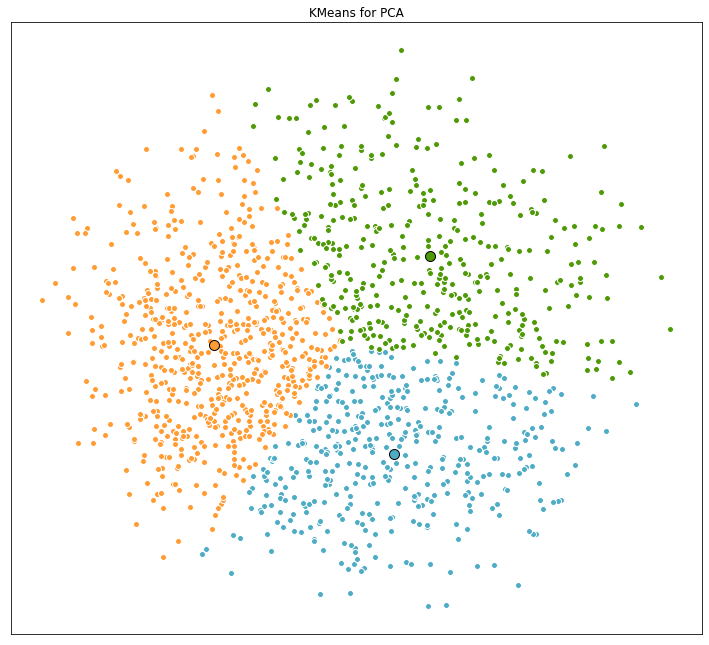

In [84]:
X = merged_df[traits_columns].values

centers = [[-100, -100], [-50, 50], [100, 100]]
n_clusters = len(centers)

reduced_data = PCA(n_components=2).fit_transform(X)

k_means = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
k_means.fit(reduced_data)

k_means_cluster_centers = k_means.cluster_centers_
k_means_labels = pairwise_distances_argmin(reduced_data, k_means_cluster_centers)

# KMeans
fig = plt.figure(figsize=(10, 10))
fig.subplots_adjust(left=0.02, right=0.98, bottom=0.05, top=0.9)
ax = fig.add_subplot(1, 1, 1)
for k, col in zip(range(n_clusters), colors):

    my_members = k_means_labels == k
    cluster_center = k_means_cluster_centers[k]
    ax.plot(reduced_data[my_members, 0], reduced_data[my_members, 1], 'w',
            markerfacecolor=col, marker='o', markersize=6)
    ax.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
            markeredgecolor='k', markersize=10)


ax.set_title(f'KMeans for PCA')
plt.xticks(())
plt.yticks(())

plt.show()

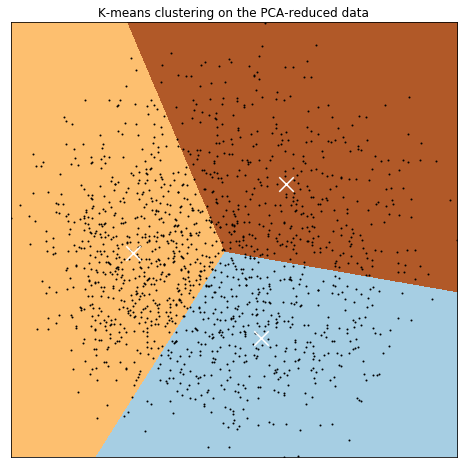

In [85]:
x_min, x_max = reduced_data[:, 0].min() - 1, reduced_data[:, 0].max() + 1
y_min, y_max = reduced_data[:, 1].min() - 1, reduced_data[:, 1].max() + 1

h = 0.25     # point in the mesh [x_min, x_max]x[y_min, y_max].

xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))

Z = k_means.predict(np.c_[xx.ravel(), yy.ravel()])
Z = Z.reshape(xx.shape)

plt.figure(1, figsize=(8,8))
plt.clf()
plt.imshow(Z, interpolation="nearest",
           extent=(xx.min(), xx.max(), yy.min(), yy.max()),
           cmap=plt.cm.Paired, aspect="auto", origin="lower")

plt.plot(reduced_data[:, 0], reduced_data[:, 1], 'k.', markersize=2)
# Plot the centroids as a white X
centroids = k_means.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1], marker="x", s=210, linewidths=15,
            color="w", zorder=10)
plt.title("K-means clustering on the PCA-reduced data")
plt.xlim(x_min, x_max)
plt.ylim(y_min, y_max)
plt.xticks(())
plt.yticks(())
plt.show()


In [103]:
gender_columns = ['rich,poor', 'beautiful,ugly', 'never cries,often crying', 'masculine,feminine', 'simple,complicated', 'normal,weird', 'moody,stable', 'forgiving,vengeful', 'rude,respectful', 'creepy,disarming', 'thinker,doer', 'politically correct,edgy']

combinations = list(itertools.combinations(gender_columns, 2))


len(combinations)

handpicked_combinations = (('beautiful,ugly','normal,weird'), ('masculine,feminine','never cries,often crying'), ('beautiful,ugly', 'forgiving,vengeful'), ('moody,stable', 'rude,respectful'))
combinations = [ handpicked_combinations[3] ]
combinations

[('moody,stable', 'rude,respectful')]

# Cluster on some combinations

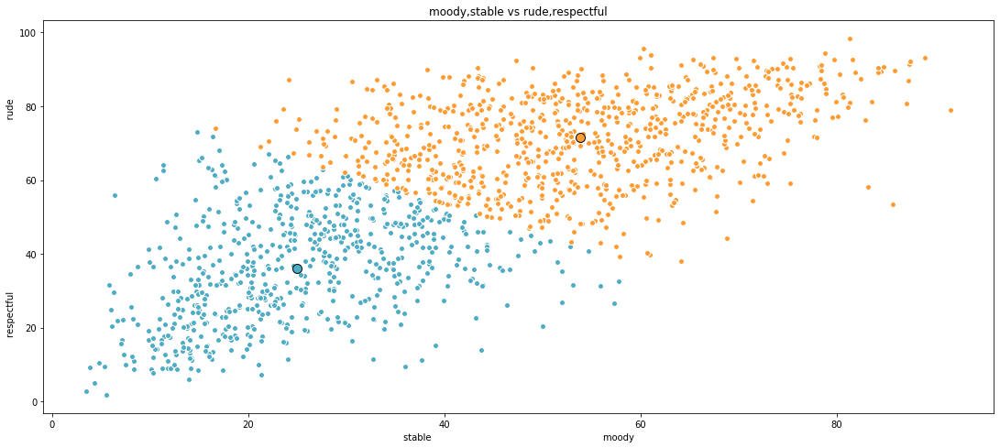

In [104]:
columns = 1


fig = plt.figure(figsize=(15, (7/columns) * len(combinations)))
fig.subplots_adjust(left=0.02, right=0.98, bottom=0.05, top=0.9)

for i, combination in enumerate(combinations, start=1):
    #print(i, combination)
    X = merged_df[[combination[0], combination[1]]].values

    centers = [[-100, -100], [100, 100]]
    n_clusters = len(centers)

    k_means = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
    k_means.fit(X)

    k_means_cluster_centers = k_means.cluster_centers_
    k_means_labels = pairwise_distances_argmin(X, k_means_cluster_centers)

    # KMeans
    ax = fig.add_subplot(len(combinations) / columns, columns, i)
    for k, col in zip(range(n_clusters), colors):

        my_members = k_means_labels == k
        cluster_center = k_means_cluster_centers[k]
        ax.plot(X[my_members, 0], X[my_members, 1], 'w',
                markerfacecolor=col, marker='o', markersize=6)
        ax.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
                markeredgecolor='k', markersize=10)



    ax.set_title(f'{combination[0]} vs {combination[1]}')
    ax.set_xlabel(combination[0].split(',')[1] + (" " * 60) + combination[0].split(',')[0])
    ax.set_ylabel(combination[1].split(',')[1] + (" " * 60) + combination[1].split(',')[0])

#ax.set_xticks(())
#ax.set_yticks(())

plt.show()


# Cluster with one axis fixed

In [201]:

fixed_axis = 'masculine,feminine'

fig = plt.figure(figsize=(25, 800))
fig.subplots_adjust(left=0.02, right=0.98, bottom=0.05, top=0.9)
#colors = ['#4EACC5', '#FF9C34', '#4E9A06']

for i, column in enumerate(traits_columns, start=1):
    #print(i, combination)
    X = merged_df[[fixed_axis, column]].values

    centers = [[-100, -100], [100, 100]]
    n_clusters = len(centers)

    k_means = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
    k_means.fit(X)

    k_means_cluster_centers = k_means.cluster_centers_
    k_means_labels = pairwise_distances_argmin(X, k_means_cluster_centers)

    # KMeans
    ax = fig.add_subplot((len(traits_columns) / 2) + 1, 2, i)
    for k, col in zip(range(n_clusters), colors):

        my_members = k_means_labels == k
        cluster_center = k_means_cluster_centers[k]
        ax.plot(X[my_members, 0], X[my_members, 1], 'w',
                markerfacecolor=col, marker='o', markersize=6)
        ax.plot(cluster_center[0], cluster_center[1], 'o', markerfacecolor=col,
                markeredgecolor='k', markersize=10)



    ax.set_title(f'{fixed_axis} vs {column}')
    ax.set_xlabel(fixed_axis.split(',')[1] + (" " * 60) + fixed_axis.split(',')[0])
    ax.set_ylabel(column.split(',')[1] + (" " * 60) + column.split(',')[0])

#ax.set_xticks(())
#ax.set_yticks(())

plt.show()
